<a href="https://colab.research.google.com/github/headunderheels/GEOG-413/blob/main/03_zonal_statistics.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Lab 3: Zonal Statistics

In our labs so far, we have been pulling data from Google Earth Engine to visualize in a variety of ways. While visualization is powerful, sometimes we need solid numbers to back up our science. In this event, we need to get zonal statistics.

## Requirements

Everytime you open a new notebook (or your kernel disconnects) you will need to run these requirements before you are able to produce any maps.

The 'pip install' lines are commented out becuase most everyone should already have these libraries installed on your devices, but in case you do not, uncomment and run the first two lines.

In [ ]:
# ! pip install geemap
# ! pip install pygis

import geemap
import ee
from geemap import basemaps

ee.Authenticate()
ee.Initialize(project='utk-dryver2206') # Replace 'YOUR_PROJECT_NAME' with the name of your earth engine cloud project

This week, we are introducing some new dependencies. These will help us visualize the statistics we get!

The main one we will focus on is Dr. Qiusheng Wu's [Leafmap](https://leafmap.org/). This is a very powerful python package that can easily integrate geemap data.

In [ ]:
%pip install mapclassify
%pip install leafmap

import leafmap
import pandas as pd
import geopandas as gpd
import numpy as np
import matplotlib.pyplot as plt
import mapclassify

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 59.1/59.1 kB 2.6 MB/s eta 0:00:00
  Using cached jedi-0.19.1-py2.py3-none-any.whl.metadata (22 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 483.0/483.0 kB 26.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 213.7/213.7 kB 17.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.1/6.1 MB 81.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.6/108.6 kB 7.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 72.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 727.4/727.4 kB 40.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 182.9/182.9 kB 16.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.4/72.4 kB 6.3 MB/s eta 0:00:00
Using cached jedi-0.19.1-py2.py3-none-any.whl (1.6 MB)


## Review Lab 2

In our last lab, we learned how to beef up our maps a with legends, color bars, and labels as well as how to visual timeseries data.

In your first challenge question, you were asked to display county/regional boundries of a nation/state. Here's the quickest way to visualize both of those:


In [ ]:
# Define Labels Map
labels = geemap.Map(center=[40, -100], zoom=4, basemap='HYBRID')

# Define Feature Collection
counties = ee.FeatureCollection("TIGER/2018/Counties")

# Custom Visualization Parameters
style = {'color': 'yellow', 'fillColor': "00000000"}

# Filter the counties for the specified state
filtered = counties.filter(ee.Filter.eq('STATEFP', '44'))  # Change the '44' to another state's code

# Add Layer to Map
labels.addLayer(
    filtered.style(**style),  # Image (styled with our customo parameters)
     {},                    # Leave blank
    "US States"             # Layer Title
)

labels.add_labels(
    data=filtered,      # Define dataset
    column="NAME",      # Define which field to use as labels
    font_size="8pt",
    font_color="white",
    font_family="arial",
)

# Display Map
labels.centerObject(filtered, 8)
labels

Map(center=[41.59400806423676, -71.52472106430231], controls=(WidgetControl(options=['position', 'transparent_…

In [ ]:
country = geemap.Map(basemap='HYBRID')

countries = ee.FeatureCollection("FAO/GAUL/2015/level1")

filtered = countries.filter(ee.Filter.eq('ADM0_NAME', 'Georgia')) # Change 'Georgia' to country of your choice

# Custom Visualization Parameters
style = {'color': 'yellow', 'fillColor': "00000000"}

# Add Layer to Map
country.addLayer(
    filtered.style(**style),  # Image (styled with our custom parameters)
     {},                    # Leave blank
    "Georgia"             # Layer Title
)

country.add_labels(
    data=filtered,          # Define dataset
    column="ADM1_NAME",      # Define which field to use as labels
    font_size="8pt",
    font_color="white",
    font_family="arial",
)

# Display Map
country.centerObject(filtered, 7)
country

Map(center=[42.183808015099615, 43.529175850684894], controls=(WidgetControl(options=['position', 'transparent…

In the second challenge question, you applied the timeseries inspector function to a dataset that possed some unique issues. Below is the quickest code to do so, with some explanation in the ' ' ' comments ' ' '.

In [ ]:
aet = geemap.Map(center=[40, -100], zoom=4)

'''

In this example, we are using the Terra Climate Image Collection, which is
equipped with many products. However, we only need one - which is contained
in the 'aet' band. We will need to .select() this band to be able to use it
in the timeseries inspector.

Additionally, you will notice this Image Collection contains monthly climactic
data going back over 65 years. Because of this, we must use the .filterDate()
function. To include all 12 months in a year, we will start with YYYY-01-01
and end with YYYY-12-31.

'''

collection = (
    ee.ImageCollection("IDAHO_EPSCOR/TERRACLIMATE") # Image Collection
    .filterDate('2021-01-01','2021-12-31') # Filter by Date
    .select('aet') # Select the band we want
)

'''

Visualation Parameters are, as you learned, very important and quite picky.
This specific Image Collection is not equipped with default visualizaiton
parameters, so we have to define our own.

Additionally, when viewing the 'Bands' section of the Goggle Earth Engine Data
Catalog, you will find the 'min' and 'max' values that are given (0 and 3140,
respectively) does not properly visualize the data. This is because we are also
give a 'Scale' value of 0.1, which is applied to the given min/max values.

scaled_min  =   'min' * 'Scale'    =   0    * 0.1  =   0
scaled_max  =   'max' * 'Scale'    =   3140 * 0.1  =   314

Also, we need to define a color palette. The number of colors you use will
determine your number of classes. For this example, let's use 5 classes, so
5 colors. To range from yellow for low values, to red for high values, let's
use theese hex codes:

#ffe940
#ffd877
#fdcfa5
#d47a47
#a60000

We will need to format these values into a list format by putting them in
[brackets], and separating them with commas, as shown below.

'''

vis_params = {
    'min': 0,       # Our scaled_min value
    'max': 314.0,   # Our scaled_max value
    'palette': ['ffe940','ffd877','fdcfa5','d47a47','a60000'],  # Our colors, in a [list] format
}

'''

The last bit of information we need for our TS Inspector are the labels for
our dropdown box options. There are, of course, many different ways to do this.
Below are 2 viable options.

To un#comment the lines of code, highlight the lines and press 'ctrl + /' or
'command + /' on a Mac.

'''

## Option 1: Get Labels from Dataset with .getInfo()

# years = collection.aggregate_array('system:index').getInfo()

## Option 2: Create Labels Manually

years = ['2021-01', '2021-02', '2021-03', '2021-04', '2021-05', '2021-06',
        '2021-07', '2021-08', '2021-09', '2021-10', '2021-11', '2021-12']

'''

Now, we add each variable we define to our .ts_inspector() function. Each
field will be the same for the left and right sides.

collection == our Image Collection
years == our labels
vis_params == our visualization parameters

'''

aet.ts_inspector(
    left_ts=collection,     # Image Collection
    right_ts=collection,    # Image Collection
    left_names=years,       # Labels
    right_names=years,      # Labels
    left_vis=vis_params,    # Visualization Parameters
    right_vis=vis_params,   # Visualization Parameters
    width='80px',           # Size of our dropdown boxes
)

'''

We will now add a color bar to our map, so users can read it. Since we want
it to line up with the image we are visualizing, we will use the same
vis_params we defined above. Otherwise, the color bar will not line up with
our image.

'''

# Add Colorbar to Map
aet.add_colorbar(
    vis_params,             # Visualization parameters
    label="Evapotrans",     # Label for Colorbar
    layer_name="Evapotrans" # Layer Title
    )

# Display Map with Layers
aet

Map(center=[40, -100], controls=(WidgetControl(options=['position', 'transparent_bg'], widget=Dropdown(layout=…

## Graded Section

This lab is broken into two section:

1. Conceptual - 4 questions (60% total)
2. Challenge - 2 question (40% total)

### Conceptual Questions

15 Points Each

1. Which three provinces of China have the highest mean eleveation? Which have the highest maximum? Explain why those might be different.

2. Compare the Pennsylvania Sum and Percentage maps. Which counties seem to be most affected by the different stastics used? Why do you think that is?

3. For the China Elevation and Pennsylvania Cultivated Land maps, which statistic do you think best represented the data? Why?

4. Interpret the line graph from the Timeseries Zonal Statistics section. What values are being represented? What does the change along the line represent?

### Challenge Questions

1) Create a choropleth map that includes mean NDVI for counties in a US state *OR*  regions/provinces in a country of your choosing from a single image.

Specific Requirements:
* Make the color scale 'Greens'.
* Use a color map scheme OTHER THAN 'NaturalBreaks'.

Datasets:
* [NDVI](https://developers.google.com/earth-engine/datasets/catalog/MODIS_061_MOD13Q1)
* [Counties](https://developers.google.com/earth-engine/datasets/catalog/TIGER_2016_Counties)

Here's an example of a map that would receive full credit:

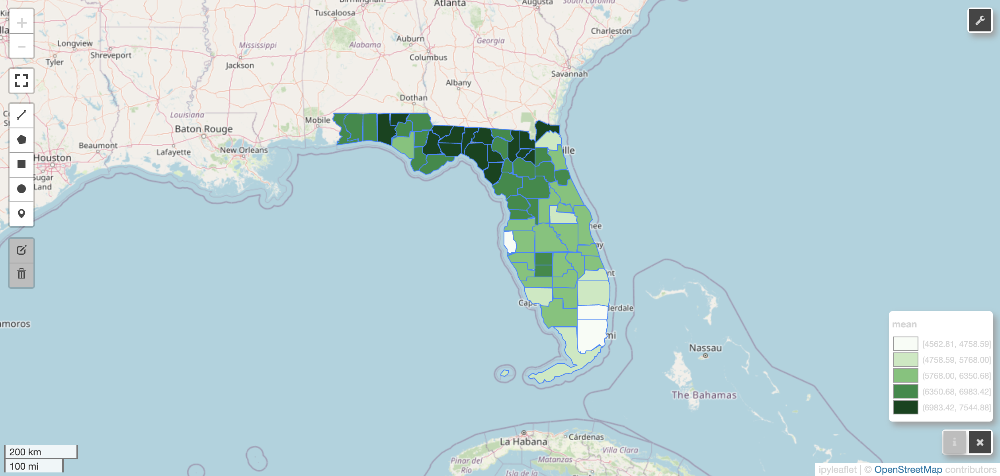

2) Using TerraClimate data, display the SUM precipitation in a given month for either each county in a state of your choice *OR*  each province/region in a country of your choice.

Specific Requirements:
* Use a color map scheme that you HAVEN'T used yet
* Your color scale should be either ('viridis', 'plasma', 'magma', 'inferno', or 'cividis')

Datasets:
* [Precipitation](https://developers.google.com/earth-engine/datasets/catalog/IDAHO_EPSCOR_TERRACLIMATE)
* [Counties](https://developers.google.com/earth-engine/datasets/catalog/TIGER_2016_Counties)

Here's an example of a map that would receive full credit:

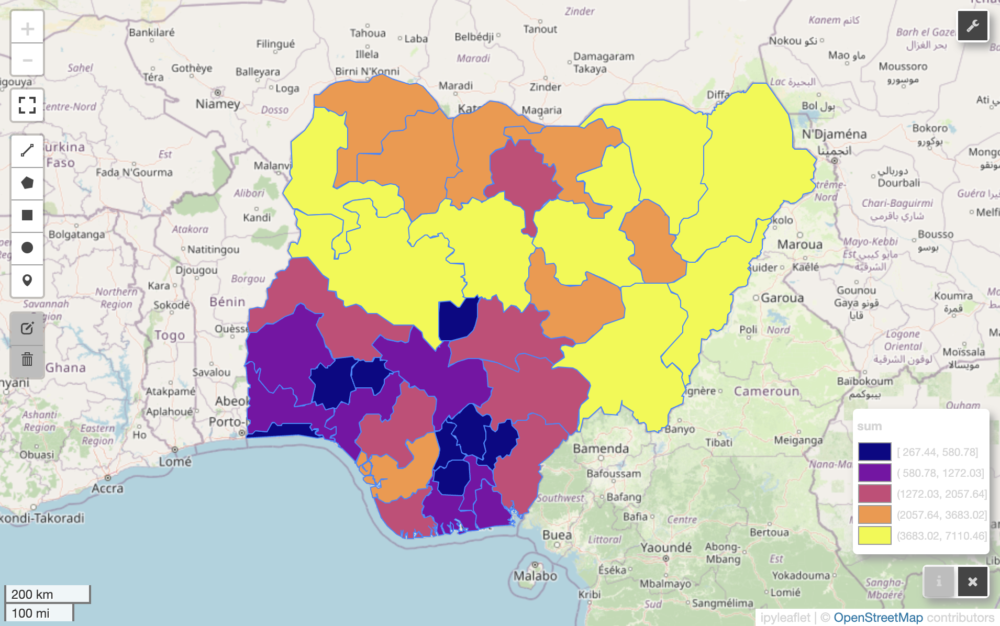

## 1. Zonal Stats on Single Band

Sometimes, our project is focused on a specific area and we only need to get information on one band that's stored in an image. To do this, we use the geemap.zonal_stats() function.

### 1.1 USGS Elevation

#### 1.1.1 Mean

In [ ]:
# Define datasets
dem = ee.Image('USGS/SRTMGL1_003').select('elevation')
china = ee.FeatureCollection("FAO/GAUL/2015/level1").filter(
    ee.Filter.eq('ADM0_NAME', 'China')
    )

In [ ]:
# Define output location
out_dem_stats = 'dem_mean.csv'

# Run zonal stats
geemap.zonal_stats(
    dem,  # Dataset
    china,  # Region
    out_dem_stats,  # Output
    stat_type='MEAN',   # Statistic type
    scale=1000,   # Since we want our data in meters, not mm
    return_fc=False,
)

Computing statistics ...
Generating URL ...
Please wait ...
Data downloaded to /content/dem_mean.csv


In [ ]:
# Convert the EE FeatureCollection to GeoDataFrame using geemap
china_gdf = geemap.ee_to_gdf(china)

# # Load the CSV file with mean elevation data
csv_path = '/content/dem_mean.csv'  # Replace with your CSV file path
elevation_df = pd.read_csv(csv_path)

# Ensure there's a common key for merging
# china_gdf = china_gdf.rename(columns={'ADM1_NAME': 'ADM1_NAME'})  # Fields we join tables with

# Merge the China boundaries GeoDataFrame with the CSV elevation data
china_merged = china_gdf.merge(elevation_df, on='ADM1_NAME')

# Initialize the map centered around China
mean = leafmap.Map(center=[35, 105], zoom=4)

# Visualize the choropleth directly using add_data()
mean.add_data(china_merged,
            column='mean',  # Data column to map
            cmap='YlGnBu',  # Color map
            scheme='NaturalBreaks',  # Color scale
            )

# Display the map (for Jupyter or interactive environments)
mean

Map(center=[35, 105], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_te…

#### 1.1.2 Maximum

In [ ]:
# Define datasets
dem = ee.Image('USGS/SRTMGL1_003').select('elevation')
china = ee.FeatureCollection("FAO/GAUL/2015/level1").filter(
    ee.Filter.eq('ADM0_NAME', 'China')
    )

In [ ]:
# Define output file napme
out_dem_stats = 'dem_max.csv'

# Run Zonal Stats
geemap.zonal_stats(
    dem,  # Dataset
    china,  # Region
    out_dem_stats,  # Output
    stat_type='MAXIMUM',   # Statistic type
    scale=1000,
    return_fc=False ,
)

Computing statistics ...
Generating URL ...
Please wait ...
Data downloaded to /content/dem_max.csv


In [ ]:
# Load the CSV file with mean elevation data
csv_path = '/content/dem_max.csv'  # Replace with your CSV file path
elevation_df = pd.read_csv(csv_path)

# Ensure there's a common key for merging
china_gdf = china_gdf.rename(columns={'ADM1_NAME': 'ADM1_NAME'})  # Adjust as per the actual column name in FAO dataset

# Merge the China boundaries GeoDataFrame with the CSV elevation data
# Assuming 'region_name' is the common key
china_merged = china_gdf.merge(elevation_df, on='ADM1_NAME')

# Initialize the map centered around China
max = leafmap.Map(center=[35, 105], zoom=4)

# Visualize the choropleth directly using explore()
max.add_data(china_merged,
            column='max',  # Data column to map
            cmap='YlGnBu',  # Color scale
            scheme='NaturalBreaks')

max

Map(center=[35, 105], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_te…

In [ ]:
mean

Map(center=[35, 105], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_te…

## 2. Zonal Stats on Multiple Bands

Sometimes, we need the statistics on multiple bands in a dataset. In this case, we must use the geemap.zonal_stats_by_group() function.

Additionally, we can change the color scale and color maps when we visualize in leafmap. Color scale determines how we organize our data in our visualization. Color map is the gradient of colors we choose for our classes.

Here is a link to a list of options for:

 *  [Color map](https://matplotlib.org/3.3.4/tutorials/colors/colormaps.html#sphx-glr-tutorials-colors-colormaps-py)
 *  [Color scale](https://pysal.org/notebooks/viz/mapclassify/intro.html)


### 2.1 NLCD Landcover

The NLCD dataset has a band for each landcover class, so lets get the statistics for each class in our study area!

#### 2.1.1 Sum

The sum function will give us the total number of pixels in our study area for each class. For this example, we will focus on cultivated lands in Pennsylvanian counties.

In [ ]:
# Add NLCD data
dataset = ee.Image('USGS/NLCD_RELEASES/2019_REL/NLCD/2019')
landcover = dataset.select('landcover')  # Select the landcover band

# Add US census states
counties = ee.FeatureCollection("TIGER/2018/Counties")
PA_counties = counties.filter(ee.Filter.eq('STATEFP', '42'))  # Filter for Pennsylvania (STATEFP = 42)

In [ ]:
# Define output directory
nlcd_stats = 'nlcd_sum.csv'

# Run zonal stats
geemap.zonal_stats_by_group(
    landcover,  # Dataset
    PA_counties,  # Region
    nlcd_stats, # Outful file
    stat_type='SUM',  # Stat Type
    denominator=1e6,  # (Optional) data formatting
    decimal_places=2, # (Optional) data formatting
)

Computing ... 
Generating URL ...
Please wait ...
Data downloaded to /content/nlcd_sum.csv


In [ ]:
# Convert the EE FeatureCollection to GeoDataFrame using geemap
states_gdf = geemap.ee_to_gdf(PA_counties)

# Load the CSV file with mean elevation data
csv_path = '/content/nlcd_sum.csv'  # Replace with your CSV file path
landcover_df = pd.read_csv(csv_path)

# Merge the China boundaries GeoDataFrame with the CSV elevation data
# Use landcover_df instead of elevation_df
states_merged = states_gdf.merge(landcover_df, on='NAME')

# Initialize the map centered around Pennsylvania
pa_sumEI = leafmap.Map(center=[41, -77], zoom=7)

# Visualize the choropleth directly using explore()
pa_sumEI.add_data(states_merged,
            column='Class_82',  # Data column to map
            cmap='YlOrBr',  # Color map
            scheme='EqualInterval',  # Data scheme
            )

# Display the map (for Jupyter or interactive environments)
pa_sumEI

HTML(value="<html>\n<body>\n  <div class='my-legend'>\n  <div class='legend-title'>Class_82</div>\n  <div clas…

Map(center=[41, -77], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_te…

In [ ]:
# Initialize the map centered around Pennsylvania
pa_sum = leafmap.Map(center=[41, -77], zoom=7)

# Visualize the choropleth directly using explore()
pa_sum.add_data(states_merged,
            column='Class_82',  # Data column to map
            cmap='YlOrBr',  # Color map
            scheme='NaturalBreaks',  # Data scheme
            )

# Display the map (for Jupyter or interactive environments)
pa_sum

#### 2.1.2 Percentage

The percentage statistic will give us each class in our dataset as a percentage of total pixels for our study area. So, in this example, we will find what percentage of pixels in each county are classified as cultivated lands.

In [ ]:
# Add NLCD data
dataset = ee.Image('USGS/NLCD_RELEASES/2019_REL/NLCD/2019')
landcover = dataset.select('landcover')  # Select the landcover band

# Add US census states
counties = ee.FeatureCollection("TIGER/2018/Counties")
PA_counties = counties.filter(ee.Filter.eq('STATEFP', '42'))  # Filter for Pennsylvania (STATEFP = 42)

In [ ]:
# Define output directory
nlcd_stats = 'nlcd_pct.csv'

# Run zonal stats
geemap.zonal_stats_by_group(
    landcover,  # Dataset
    PA_counties,  # Region
    nlcd_stats, # Outful file
    stat_type='PERCENTAGE', # Stat Type
    denominator=1e6,  # (Optional) data formatting
    decimal_places=2, # (Optional) data formatting
)

In [ ]:
# Convert the EE FeatureCollection to GeoDataFrame using geemap
counties_gdf = geemap.ee_to_gdf(PA_counties)

# Load the CSV file with mean elevation data
csv_path = '/content/nlcd_pct.csv'  # Replace with your CSV file path
landcover_df = pd.read_csv(csv_path)

# Merge the China boundaries GeoDataFrame with the CSV elevation data
# Use landcover_df instead of elevation_df
counties_merged = counties_gdf.merge(landcover_df, on='NAME')

# Initialize the map centered around Pennsylvania
pa_pct = leafmap.Map(center=[41, -77], zoom=7)

# Visualize the choropleth directly using explore()
pa_pct.add_data(counties_merged,
            column='Class_82',  # Data column to map
            cmap='YlOrBr',  # Color map
            scheme='NaturalBreaks',  # Color scale
            )

# Display the map (for Jupyter or interactive environments)
pa_pct

In [ ]:
pa_sum

## (EXTRA) Timeseries Zonal Statistics

This section is an advanced example. You will not need this for your challenge questions. You will, however, be asked to interpret the graph in your last Conceptual Question.

In [ ]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

ndvi = ee.ImageCollection("MODIS/061/MOD13Q1").filter(
    ee.Filter.date('2020-01-01', '2020-12-31'))
states = ee.FeatureCollection("TIGER/2018/States")
wv = states.filter(ee.Filter.eq('STUSPS', 'WV'))

In [ ]:
# Directory where CSV files will be saved
output_dir = "ndvi_stats"  # Change to the directory where you want to save the CSV files
os.makedirs(output_dir, exist_ok=True)  # Create the directory if it doesn't exist

# Loop through each feature (image) to calculate zonal statistics
for feat in ndvi.getInfo()['features']:
    image = ee.Image(feat['id'])  # Extract the image from the feature dictionary using its ID

    # Get the image date from its properties to use it in the filename
    image_date = ee.Date(feat['properties']['system:time_start']).format('YYYY-MM-dd').getInfo()

    # Generate a unique filename for each CSV
    out_ndvi_stats = os.path.join(output_dir, f'ndvi_mean_{image_date}.csv')

    # Perform zonal statistics and save the results to CSV
    geemap.zonal_stats(
        image,
        wv,  # The region of interest (ROI)
        out_ndvi_stats,  # Output CSV file path
        statistics_type='MEAN',
        scale=500
    )

    print(f"Saved NDVI statistics for {image_date} to {out_ndvi_stats}")

Computing statistics ...
Generating URL ...
Please wait ...
Data downloaded to /content/ndvi_stats/ndvi_mean_2020-01-01.csv
Saved NDVI statistics for 2020-01-01 to ndvi_stats/ndvi_mean_2020-01-01.csv
Computing statistics ...
Generating URL ...
Please wait ...
Data downloaded to /content/ndvi_stats/ndvi_mean_2020-01-17.csv
Saved NDVI statistics for 2020-01-17 to ndvi_stats/ndvi_mean_2020-01-17.csv
Computing statistics ...
Generating URL ...
Please wait ...
Data downloaded to /content/ndvi_stats/ndvi_mean_2020-02-02.csv
Saved NDVI statistics for 2020-02-02 to ndvi_stats/ndvi_mean_2020-02-02.csv
Computing statistics ...
Generating URL ...
Please wait ...
Data downloaded to /content/ndvi_stats/ndvi_mean_2020-02-18.csv
Saved NDVI statistics for 2020-02-18 to ndvi_stats/ndvi_mean_2020-02-18.csv
Computing statistics ...
Generating URL ...
Please wait ...
Data downloaded to /content/ndvi_stats/ndvi_mean_2020-03-05.csv
Saved NDVI statistics for 2020-03-05 to ndvi_stats/ndvi_mean_2020-03-05.csv


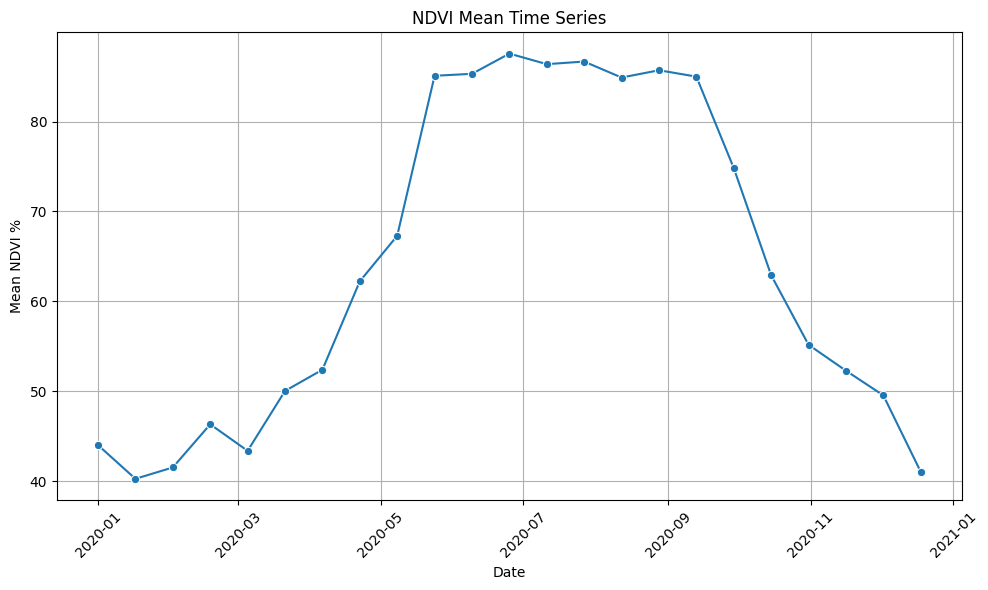

In [ ]:
# List all CSV files in the directory
csv_files = [os.path.join(output_dir, f) for f in os.listdir(output_dir) if f.endswith('.csv')]

# Initialize an empty list to store individual dataframes
dataframes = []

# Loop through the CSV files and read each into a dataframe
for csv_file in csv_files:
    # Read the CSV file
    df = pd.read_csv(csv_file)

    # Extract the date from the filename
    date_str = os.path.basename(csv_file).replace('ndvi_mean_', '').replace('.csv', '')

    # Add a 'date' column to the dataframe
    df['date'] = date_str

    # Append the dataframe to the list
    dataframes.append(df)

# Combine all the individual dataframes into a single dataframe
combined_df = pd.concat(dataframes, ignore_index=True)

# Convert the 'date' column to a datetime object for easier plotting
combined_df['date'] = pd.to_datetime(combined_df['date'])

# Sort the dataframe by date
combined_df = combined_df.sort_values('date')

# Divide 'NDVI' Values by 1000
combined_df['NDVI'] = combined_df['NDVI'] / 100

# Plot the time series of NDVI values using Seaborn or Matplotlib
plt.figure(figsize=(10, 6))
sns.lineplot(data=combined_df, x='date', y='NDVI', marker='o')  # Use 'NDVI' for y-axis

# Customize the plot
plt.title('NDVI Mean Time Series')
plt.xlabel('Date')
plt.ylabel('Mean NDVI %')
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability
plt.grid(True)

# Show the plot
plt.tight_layout()
plt.show()